In [563]:
import pandas as pd
import numpy as np
from datetime import datetime, timedelta
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from scipy.signal import savgol_filter
from estival.wrappers import pymc as epm
import pymc as pm

In [564]:
from summer2 import CompartmentalModel, Stratification, Multiply
from summer2.parameters import Parameter
from summer2.functions import get_piecewise_scalar_function

In [565]:
def pcwise_temp(x,domain,breakpts,vals):
    y = np.empty_like(x)
    num_intervals = len(breakpts)+1
    masks = []
    m = (domain[0] <= x) & (x <= breakpts[0])
    masks.append(m)
    for i in range(1,num_intervals-1):
        m = (breakpts[i-1] < x) & (x <= breakpts[i])
        masks.append(m)
    m = (breakpts[len(breakpts)-1] < x) & (x <= domain[1])
    masks.append(m)
    for j in range(0,num_intervals):
        y[masks[j]] = vals[j]
    return y

def pcwise_fcn(domain,breakpts,vals):
    def f(x):
        y = pcwise_temp(x,domain,breakpts,vals)
        return y 
    return f

In [566]:
#Plot piecewise function
domain = [0,10]
breakpts = [2,7]
vals = [1,2,3]
f = pcwise_fcn(domain,breakpts,vals)
xlist = np.linspace(domain[0], domain[1], num = 1000)
ylist = f(xlist)
fig = go.Figure()
fig = fig.add_trace(go.Scatter(x = xlist, y=ylist, name = "f"))
fig.show()

**Model 2: SEIQR (Stratified Infectious Compartment)**

In [567]:
def generate_transmission_parameter(num_breakpts):
    breakpts = []
    s = Parameter("len_pd"+str(1))
    breakpts.append(s)
    for i in range(2,num_breakpts+1):
        s += Parameter("len_pd"+str(i))
        breakpts.append(s)
    rates = []
    for k in range(1,num_breakpts+2):
        rates.append(Parameter("rate"+str(k)))
    return breakpts, rates

In [568]:
def generate_default_breakpts_and_rates(times,num_breakpts):
    time_length = times[1] - times[0]
    subinterval_length = time_length / (num_breakpts + 1)
    defp = {}
    for i in range(1,num_breakpts+2):
        defp["len_pd"+str(i)] = 0.9*subinterval_length
        defp["rate"+str(i)] = 0.2
    return defp

In [569]:
def generate_transmission_priors(times,num_breakpts):
    time_length = times[1] - times[0]
    subinterval_length = time_length / (num_breakpts + 1)
    priors = [esp.UniformPrior("rate1",(0,1))]
    for i in range(1,num_breakpts+1):
        priors.append(esp.UniformPrior("len_pd"+str(i),(0.25*subinterval_length,1.5*subinterval_length)))
        #prior for len_pd might need adjustments
        priors.append(esp.UniformPrior("rate"+str(i+1),(0,1)))
    return priors

In [570]:
def build_model(num_breakpts):
    #num_breakpts = number of breakpts for pcwise constant effective transmission rate parameter
    m = CompartmentalModel(
    times=[0, 268],
    compartments=["S", "E1", "E2", "E3", "E4", "I1", "I2", "I3", "I4", "Q1", "Q2", "Q3", "Q4", "Q2*", "Q3*", "Q4*", "R"],
    infectious_compartments=["I1", "I2", "I3", "I4"],
    timestep = 1,
    ref_date=datetime(2020,4,7)
    )
    m.set_initial_population({"S": 10353498.0, "E1": 360.0 , "I1": 544.0})
    #We set up a piecewise constant "effective contact rate"
    breakpts, rates = generate_transmission_parameter(num_breakpts)
    m.add_infection_frequency_flow("infection", get_piecewise_scalar_function(breakpts, rates),"S","E1") 
    #Progression rate for wild-type strain is 1/6.65 (Yu Wu et al.), which is multiplied by 4 because of the chained E compartmens
    m.add_transition_flow("progression1", 0.6,"E1","E2")
    m.add_transition_flow("progression2", 0.6,"E2","E3")
    m.add_transition_flow("progression3", 0.6,"E3","E4")
    m.add_transition_flow("progression4", 0.6,"E4","I1")
    #Detection can happen from any of the I compartments
    m.add_transition_flow("notification1", Parameter("detection_rate"),"I1","Q1")
    m.add_transition_flow("notification2", Parameter("detection_rate"),"I2","Q2")
    m.add_transition_flow("notification3", Parameter("detection_rate"),"I3","Q3")
    m.add_transition_flow("notification4", Parameter("detection_rate"),"I4","Q4")
    # We set up the ff. progressions:
    #   I1 -> I2 -> I3 -> I4 -> R
    #   (I1 ->) Q1 -> Q2* -> Q3* -> Q4* -> R
    #         (I2 ->) Q2 -> Q3* -> Q4* -> R
    #               (I3 ->) Q_3 -> Q_4* -> R
    #                     (I4 ->) Q_4 -> R
    # The progressions above are governed (ultimately) by a single parameter tau, which corresponds to the mean duration of infectiousness
    # Except for Q1 -> Q2*, Q2 -> Q3*, Q3 -> Q4*, Q4 -> R, the rate for each transition above is 4/tau (the 4 is due to the chained compartments structure).
    # To account for the detection rate, the rates for the flows Q1 -> Q2*, Q2 -> Q3*, Q3 -> Q4*, Q4 -> R are adjusted to maintain the same mean duration of infectiousness
    #Action point: Below is the assumption for now but this should be updated after checking relevant lit.
    tau = 14.0 
    m.add_transition_flow("I1_to_I2", 4/tau,"I1","I2") 
    m.add_transition_flow("I2_to_I3", 4/tau,"I2","I3") 
    m.add_transition_flow("I3_to_I4", 4/tau,"I3","I4") 
    m.add_transition_flow("I4_to_R", 4/tau,"I4","R")
    m.add_transition_flow("Q2*_to_Q3*", 4/tau,"Q2*","Q3*") 
    m.add_transition_flow("Q3*_to_Q4*", 4/tau,"Q3*","Q4*") 
    m.add_transition_flow("Q4*_to_R", 4/tau,"Q4*","R") 
    m.add_transition_flow("Q1_to_Q2*", 1/(tau - 1/Parameter("detection_rate")),"Q1","Q2*") 
    m.add_transition_flow("Q2_to_Q3*", 1/(tau - 1/Parameter("detection_rate")),"Q2","Q3*") 
    m.add_transition_flow("Q3_to_Q4*", 1/(tau - 1/Parameter("detection_rate")),"Q3","Q4*") 
    m.add_transition_flow("Q4_to_R", 1/(tau - 1/Parameter("detection_rate")),"Q4","R") 
    
    #No death dynamics for now since they are quite minimal at this point and data might not be accurate
    #Action point: Revisit this later to see if it needs updating    
    #m.add_death_flow("infection_death", Parameter("death_rate"), "I")
    #
    #Requesting Outputs
    m.request_output_for_flow("notification1", "notification1")
    m.request_output_for_flow("notification2", "notification2")
    m.request_output_for_flow("notification3", "notification3")
    m.request_output_for_flow("notification4", "notification4")
    m.request_aggregate_output(name = "notifications", sources=["notification1", "notification2", "notification3", "notification4"], save_results=True)
    #m.request_output_for_flow("infection_death", "infection_death")
    #m.request_cumulative_output(name="deaths_cumulative", source="infection_death")
    #
    #Action point: Incorporate age stratification  
    return m

In [571]:
num_breakpts = 14
m = build_model(num_breakpts)
m.get_input_parameters()

/var/folders/58/qy67y27x0jsd0h0bx4dmp2yw0000gn/T/ipykernel_1265/1103092506.py:13: DeprecationWarning:

This method is deprecated and scheduled for removal, use get_piecewise_function instead



{'detection_rate',
 'len_pd1',
 'len_pd10',
 'len_pd2',
 'len_pd3',
 'len_pd4',
 'len_pd5',
 'len_pd6',
 'len_pd7',
 'len_pd8',
 'len_pd9',
 'rate1',
 'rate10',
 'rate11',
 'rate2',
 'rate3',
 'rate4',
 'rate5',
 'rate6',
 'rate7',
 'rate8',
 'rate9'}

In [572]:
defp_breakpts_rates = generate_default_breakpts_and_rates([m.times.min(),m.times.max()], num_breakpts)
parameters = {
    "rate1": 0.15, 
    "detection_rate": 0.3}
parameters.update(defp_breakpts_rates)

In [573]:
parameters

{'rate1': 0.2,
 'detection_rate': 0.3,
 'len_pd1': 21.927272727272726,
 'len_pd2': 21.927272727272726,
 'rate2': 0.2,
 'len_pd3': 21.927272727272726,
 'rate3': 0.2,
 'len_pd4': 21.927272727272726,
 'rate4': 0.2,
 'len_pd5': 21.927272727272726,
 'rate5': 0.2,
 'len_pd6': 21.927272727272726,
 'rate6': 0.2,
 'len_pd7': 21.927272727272726,
 'rate7': 0.2,
 'len_pd8': 21.927272727272726,
 'rate8': 0.2,
 'len_pd9': 21.927272727272726,
 'rate9': 0.2,
 'len_pd10': 21.927272727272726,
 'rate10': 0.2,
 'len_pd11': 21.927272727272726,
 'rate11': 0.2}

In [574]:
m.run(parameters)

In [575]:
fig = px.line(m.get_outputs_df())
fig.show()

/Users/mark/miniconda3/envs/summer2/lib/python3.10/site-packages/_plotly_utils/basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



In [576]:
fig = px.line(m.get_derived_outputs_df())
fig.show()

/Users/mark/miniconda3/envs/summer2/lib/python3.10/site-packages/_plotly_utils/basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



**Targets**

In [577]:
df=pd.read_excel(io='InfectionsData_060120_093020.xlsx',index_col=0)
notification_data = df["NOTIFICATIONS"]
#death_data = df["CUMULATIVE DEATHS"]

In [578]:
notification_smoothed = savgol_filter(notification_data, window_length=12, polyorder=2)
notification_smoothed = pd.DataFrame(notification_smoothed, index=notification_data.keys())
notification_smoothed = notification_smoothed.rename(columns={0:'smoothed_data'})
notification_smoothed = notification_smoothed['smoothed_data']

In [579]:
fig = px.line(notification_data)
fig = fig.add_trace(go.Scatter(x = notification_smoothed.keys(), y=notification_smoothed, name = "smoothed"))
fig.show()

/Users/mark/miniconda3/envs/summer2/lib/python3.10/site-packages/_plotly_utils/basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



In [580]:
notification_target = notification_smoothed[31::2]
#death_data_cal = death_data[:90:2]

In [581]:
fig = px.scatter(notification_target)
fig.show()
#death_data_cal.plot(style='.')

/Users/mark/miniconda3/envs/summer2/lib/python3.10/site-packages/_plotly_utils/basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



**Optimization**

In [582]:
# Targets represent data we are trying to fit to
from estival import targets as est

# We specify parameters using (Bayesian) priors
from estival import priors as esp

# Finally we combine these with our summer2 model in a BayesianCompartmentalModel (BCM)
from estival.model import BayesianCompartmentalModel

In [583]:
# Import nevergrad
import nevergrad as ng

# Import our convenience wrapper
from estival.wrappers.nevergrad import optimize_model

In [584]:
targets = [
    #est.NormalTarget("notification", notification_data_cal, np.std(notification_data_cal) * 0.1)
    est.TruncatedNormalTarget("notifications", notification_target, (0.0,np.inf),
        esp.UniformPrior("notification_dispersion",(0.1, notification_target.max()*0.03))),
    #est.NormalTarget("deaths_cumulative", death_data_cal, np.std(death_data_cal) * 0.1)
]

In [585]:
transmission_priors = generate_transmission_priors([m.times.min(),m.times.max()],num_breakpts)

priors = [
    esp.UniformPrior("detection_rate", (0.15,0.65)),
] + transmission_priors

In [586]:
priors

[UniformPrior detection_rate {bounds: (0.15, 0.65)},
 UniformPrior rate1 {bounds: (0.0, 1.0)},
 UniformPrior len_pd1 {bounds: (6.090909090909091, 36.54545454545455)},
 UniformPrior rate2 {bounds: (0.0, 1.0)},
 UniformPrior len_pd2 {bounds: (6.090909090909091, 36.54545454545455)},
 UniformPrior rate3 {bounds: (0.0, 1.0)},
 UniformPrior len_pd3 {bounds: (6.090909090909091, 36.54545454545455)},
 UniformPrior rate4 {bounds: (0.0, 1.0)},
 UniformPrior len_pd4 {bounds: (6.090909090909091, 36.54545454545455)},
 UniformPrior rate5 {bounds: (0.0, 1.0)},
 UniformPrior len_pd5 {bounds: (6.090909090909091, 36.54545454545455)},
 UniformPrior rate6 {bounds: (0.0, 1.0)},
 UniformPrior len_pd6 {bounds: (6.090909090909091, 36.54545454545455)},
 UniformPrior rate7 {bounds: (0.0, 1.0)},
 UniformPrior len_pd7 {bounds: (6.090909090909091, 36.54545454545455)},
 UniformPrior rate8 {bounds: (0.0, 1.0)},
 UniformPrior len_pd8 {bounds: (6.090909090909091, 36.54545454545455)},
 UniformPrior rate9 {bounds: (0.0, 

In [587]:
defp = parameters

In [588]:
bcm = BayesianCompartmentalModel(m, defp, priors, targets)

**Getting initial parameters using optimization**

In [589]:
# TwoPointsDE is a good suggested default for some of our typical use cases
opt_class = ng.optimizers.TwoPointsDE
orunner = optimize_model(bcm, opt_class=opt_class)

In [590]:
# You can also suggest starting points for the optimization (as well as specify an init method for unsuggested points)
# This is the "midpoint" method by default (ie the 0.5 ppf of the prior distribution)
orunner = optimize_model(bcm, opt_class=opt_class, suggested=defp, init_method="midpoint")

In [591]:
# Here we run the optimizer in a loop, inspecting the current best point at each iteration
# Using the loss information at each step can provide the basis for stopping conditions

for i in range(8):
    # Run the minimizer for a specified 'budget' (ie number of evaluations)
    rec = orunner.minimize(800)
    # Print the loss (objective function value) of the current recommended parameters
    print(rec.loss)

60.500642269628045
51.680043152405254
50.186509118054396
48.422894493095924
48.422894493095924
47.83768813738682
47.808782599428
47.742662397498584


In [592]:
mle_params = rec.value[1]
mle_params

{'detection_rate': 0.23079641903867829,
 'rate1': 0.030824998724057952,
 'len_pd1': 8.620848521095017,
 'rate2': 0.30801380973186365,
 'len_pd2': 23.27924891074109,
 'rate3': 0.2978370963159664,
 'len_pd3': 32.69312157111784,
 'rate4': 0.5812973067863388,
 'len_pd4': 33.64965008045919,
 'rate5': 0.15133333063561738,
 'len_pd5': 9.87778535843417,
 'rate6': 0.715116503808156,
 'len_pd6': 7.842839771052962,
 'rate7': 0.21890154911366644,
 'len_pd7': 31.098780401500118,
 'rate8': 0.2251112961958698,
 'len_pd8': 19.721311646817693,
 'rate9': 0.1057735672745089,
 'len_pd9': 29.72444246436223,
 'rate10': 0.514405281081107,
 'len_pd10': 9.262710365298167,
 'rate11': 0.2526406525840858,
 'notification_dispersion': 80.03698058553452}

**Using PyMC (initial parameters = mle from optimization)**

In [593]:
bcm_mcmc = BayesianCompartmentalModel(m, mle_params, priors, targets)

In [594]:
with pm.Model() as model:

    # This is all you need - a single call to use_model
    variables = epm.use_model(bcm_mcmc)

    # The log-posterior value can also be output, but may incur additional overhead
    # Use jacobian=False to get the unwarped value (ie just the 'native' density of the priors
    # without transformation correction factors)
    # pm.Deterministic("logp", model.logp(jacobian=False))

    # Now call a sampler using the variables from use_model
    # In this case we use the Differential Evolution Metropolis sampler
    # See the PyMC docs for more details
    idata = pm.sample(step=[pm.DEMetropolis(variables)], draws=15000, tune=0,cores=4,chains=2*num_breakpts+10)

Population sampling (30 chains)
DEMetropolis: [detection_rate, rate1, len_pd1, rate2, len_pd2, rate3, len_pd3, rate4, len_pd4, rate5, len_pd5, rate6, len_pd6, rate7, len_pd7, rate8, len_pd8, rate9, len_pd9, rate10, len_pd10, rate11, notification_dispersion]
Attempting to parallelize chains to all cores. You can turn this off with `pm.sample(cores=1)`.


WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.

/Users/mark/miniconda3/envs/summer2/lib/python3.10/site-packages/pymc/step_methods/metropolis.py:844: RuntimeWarning: overflow encountered in exp
  "accept": np.exp(accept),
/Users/mark/miniconda3/envs/summer2/lib/python3.10/site-packages/pymc/step_methods/metropolis.py:844: RuntimeWarning: overflow encountered in exp
  "accept": np.exp(accept),
/Users/mark/miniconda3/envs/summer2/lib/python3.10/site-packages/pymc/step_methods/metropolis.py:844: RuntimeWarning: overflow encountered in exp
  "accept": np.exp(accept),
/Users/mark/miniconda3/envs/summer2/lib/python3.10/site-packages/pymc/step_methods/metropolis.py:844: RuntimeWarning: overflow encountered in exp
  "accept": np.exp(accept),
/Users/mark/miniconda3/envs/summer2/lib/python3.10/site-packages/pymc/step_methods/metropolis.py:844: RuntimeWarning: overflow encountered in exp
  "accept": np.exp(accept),
/Users/mark/miniconda3/envs/summer2/lib/python3.10/site-packages/pymc/step_methods/metropolis.py:844: RuntimeWarning: overflow enc

In [595]:
burn_in = 6000
chain_length = idata.sample_stats.sizes['draw']
burnt_idata = idata.sel(draw=range(burn_in, chain_length))

**Visualizing Outputs**

In [596]:
import arviz as az

In [597]:
az.summary(burnt_idata)

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
detection_rate,0.524,0.066,0.403,0.629,0.008,0.005,71.0,109.0,1.35
rate1,0.526,0.203,0.154,0.890,0.024,0.017,68.0,87.0,1.36
len_pd1,23.734,7.784,11.234,36.421,0.995,0.718,59.0,100.0,1.44
rate2,0.644,0.178,0.307,0.944,0.024,0.017,54.0,48.0,1.52
len_pd2,26.993,6.968,14.226,36.509,0.770,0.547,80.0,145.0,1.29
rate3,0.681,0.201,0.317,0.992,0.022,0.016,80.0,114.0,1.29
len_pd3,21.349,7.509,7.949,33.258,0.764,0.543,104.0,177.0,1.22
rate4,0.795,0.136,0.558,0.997,0.017,0.012,58.0,45.0,1.47
len_pd4,26.651,7.489,12.347,36.511,0.924,0.657,65.0,93.0,1.38
rate5,0.707,0.162,0.434,0.994,0.020,0.014,63.0,71.0,1.42


/Users/mark/miniconda3/envs/summer2/lib/python3.10/site-packages/arviz/plots/traceplot.py:222: UserWarning:

rcParams['plot.max_subplots'] (20) is smaller than the number of variables to plot (23), generating only 20 plots



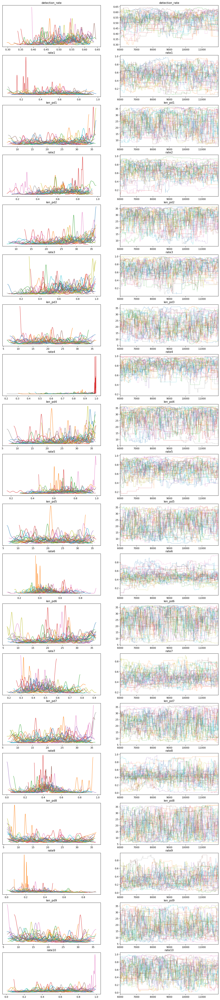

In [598]:
az.plot_trace(burnt_idata, figsize=(16,3.2*len(burnt_idata.posterior)),compact=False);#, lines=[("m", {}, mtrue), ("c", {}, ctrue)]);

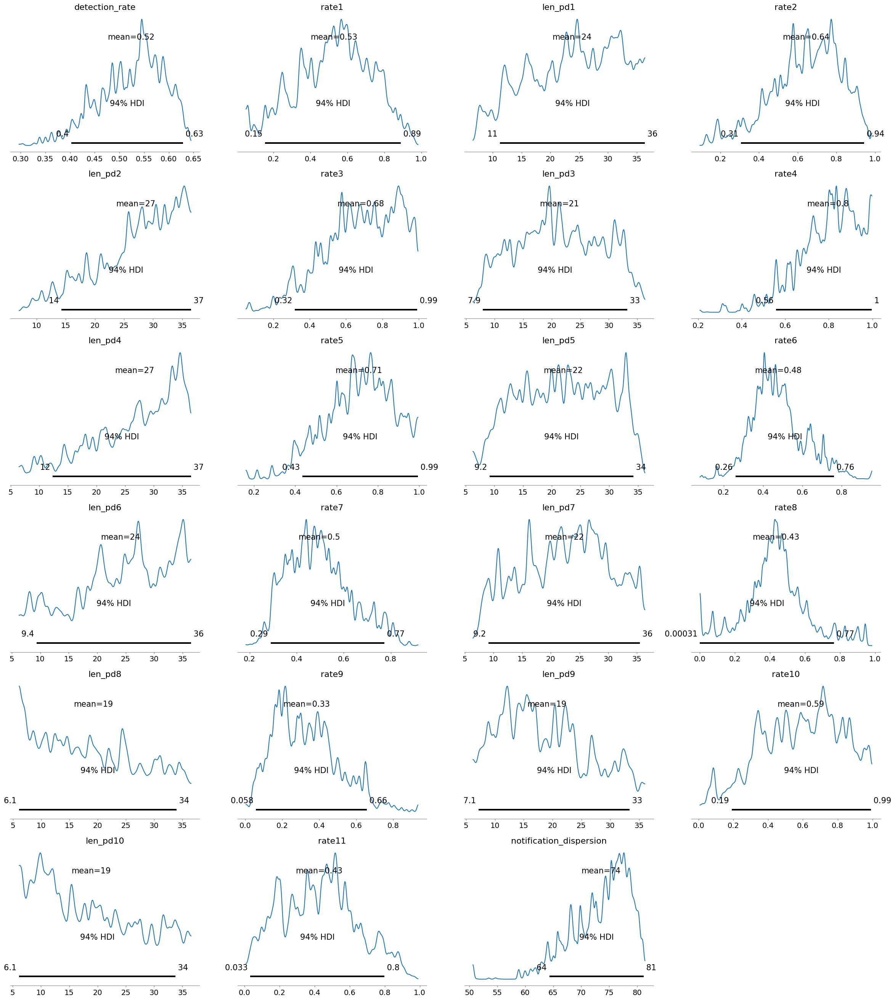

In [599]:
az.plot_posterior(burnt_idata);

**Obtaining Likelihood**

In [600]:
from estival.sampling.tools import likelihood_extras_for_idata

In [601]:
likelihood_df = likelihood_extras_for_idata(burnt_idata, bcm)

In [602]:
ldf_pivot = likelihood_df.reset_index(level="chain").pivot(columns=["chain"])

fig = go.Figure()
fig = px.line(ldf_pivot["logposterior"])
fig.show()

In [603]:
# Sort this DataFrame by logposterior to obtain the MAP index
ldf_sorted = likelihood_df.sort_values(by="logposterior",ascending=False)

# Extract the parameters from the calibration samples
map_params = burnt_idata.posterior.to_dataframe().loc[ldf_sorted.index[0]].to_dict()

map_params

{'detection_rate': 0.4872479461443584,
 'rate1': 0.43989884465392126,
 'len_pd1': 14.115576452960099,
 'rate2': 0.40220216879537607,
 'len_pd2': 26.780378937779695,
 'rate3': 0.8188038524959871,
 'len_pd3': 26.22254908029939,
 'rate4': 0.7294642493141774,
 'len_pd4': 32.38656397738403,
 'rate5': 0.8143827648912492,
 'len_pd5': 17.99818792475456,
 'rate6': 0.4327824746260313,
 'len_pd6': 33.82862430473712,
 'rate7': 0.41717052385013526,
 'len_pd7': 27.994527352328397,
 'rate8': 0.2565929230601207,
 'len_pd8': 14.106311872713984,
 'rate9': 0.49302191165394516,
 'len_pd9': 18.250658170251825,
 'rate10': 0.5111967361673289,
 'len_pd10': 20.52467586176498,
 'rate11': 0.5123617130921824,
 'notification_dispersion': 78.17487077058581}

In [604]:
bcm.loglikelihood(**map_params), ldf_sorted.iloc[0]["loglikelihood"]

(Array(-8.56234284, dtype=float64), -8.562342843155765)

In [605]:
map_res = bcm.run(map_params)

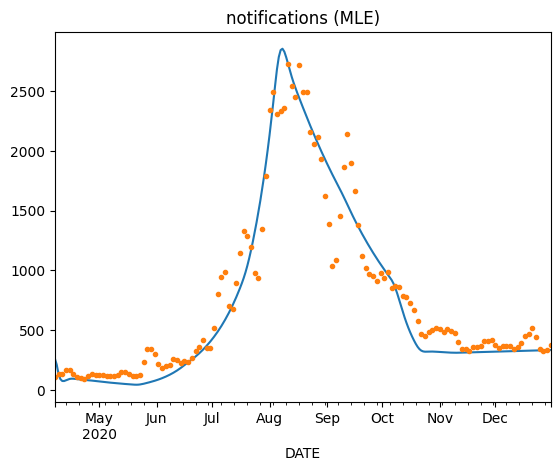

In [606]:
variable = "notifications"

pd.Series(map_res.derived_outputs[variable]).plot(title = f"{variable} (MLE)")
bcm.targets[variable].data.plot(style='.');

**Visualizing "Best" Effective Contact Rates**

In [768]:
num_best_sample = 1000
S = []
for i in range(0,num_best_sample):
    S.append(burnt_idata.posterior.to_dataframe().loc[ldf_sorted.index[i]].to_dict())

In [769]:
domain = [m.times[0],m.times.max()]

breakpts_list = []
rates_list = []

for i in range(0,num_best_sample):
    breakpts = []
    rates = []
    bp = domain[0]
    for j in range(1,num_breakpts+1):
        bp = bp + S[i]['len_pd'+str(j)]
        breakpts.append(bp)
        rates.append(S[i]['rate'+str(j)])
    rates.append(S[i]['rate'+str(num_breakpts+1)])
    breakpts_list.append(breakpts)
    rates_list.append(rates)

In [770]:
xlist = np.linspace(domain[0], domain[1], num = len(dates))
beta_vals = np.zeros(shape=(num_best_sample,int(m.times.max())+1))

for i in range(0,num_best_sample):
    f = pcwise_fcn(domain,breakpts_list[i],rates_list[i])
    ylist = f(xlist)
    beta_vals[i] = ylist

In [771]:
dates = map_res.derived_outputs[variable].keys()
fig = go.Figure()
quantiles = (0.01,0.05,0.10,0.25,0.5,0.75,0.9,0.95,0.99)

for q in quantiles:
    x = np.quantile(beta_vals,q,axis=0)
    fig = fig.add_trace(go.Scatter(x = dates, y=x, name = "quantile_"+str(q)))

#Generate breakpts and rates for mle
breakpts = []
s = mle_params["len_pd"+str(1)]
breakpts.append(s)
for i in range(2,num_breakpts+1):
    s += mle_params["len_pd"+str(i)]
    breakpts.append(s)
rates = []
for k in range(1,num_breakpts+2):
    rates.append(mle_params["rate"+str(k)])

f = pcwise_fcn(domain,breakpts,rates)
ylist = f(xlist)

fig = fig.add_trace(go.Scatter(x = dates, y=ylist, name = "mle"))

fig.add_vrect(x0="2020-04-07", x1="2020-05-16", 
              annotation_text="ECQ", annotation_position="top left",
              fillcolor="aqua", opacity=0.25, line_width=0)
fig.add_vrect(x0="2020-05-16", x1="2020-06-01", 
              annotation_text="MECQ", annotation_position="top left",
              fillcolor="pink", opacity=0.25, line_width=0)
fig.add_vrect(x0="2020-06-01", x1="2020-08-03", 
              annotation_text="GCQ", annotation_position="top left",
              fillcolor="lightgreen", opacity=0.25, line_width=0)
fig.add_vrect(x0="2020-08-03", x1="2020-08-19", 
              annotation_text="MECQ", annotation_position="top left",
              fillcolor="pink", opacity=0.25, line_width=0)
fig.add_vrect(x0="2020-08-19", x1="2020-12-31", 
              annotation_text="GCQ", annotation_position="top left",
              fillcolor="lightgreen", opacity=0.25, line_width=0)
fig.show()

**Compare with Actual Data**

In [607]:
variable = "notifications"

fig = go.Figure()
fig = fig.add_trace(go.Scatter(x = map_res.derived_outputs[variable].keys(), y = map_res.derived_outputs[variable], name = "MLE"))
fig = fig.add_trace(go.Scatter(x = notification_target.keys(), y = notification_target, name = "data"))
fig.show()

**Uncertainty Sampling**

In [748]:
num_samples = 1000
sample_idata = az.extract(burnt_idata, num_samples = num_samples)
samples_df = sample_idata.to_dataframe().drop(columns=["chain","draw"])

In [749]:
new_index = pd.Index(list(range(0,num_samples)))
S = samples_df
S = S.set_index(new_index)
S = S.to_dict(orient='records')

In [750]:
domain = [m.times[0],m.times.max()]

breakpts_list = []
rates_list = []

for i in range(0,num_samples):
    breakpts = []
    rates = []
    bp = domain[0]
    for j in range(1,num_breakpts+1):
        bp = bp + S[i]['len_pd'+str(j)]
        breakpts.append(bp)
        rates.append(S[i]['rate'+str(j)])
    rates.append(S[i]['rate'+str(num_breakpts+1)])
    breakpts_list.append(breakpts)
    rates_list.append(rates)    

In [751]:
xlist = np.linspace(domain[0], domain[1], num = len(dates))
beta_vals = np.zeros(shape=(num_samples,int(m.times.max())+1))

fig = go.Figure()

for i in range(0,num_samples):
    f = pcwise_fcn(domain,breakpts_list[i],rates_list[i])
    ylist = f(xlist)
    beta_vals[i] = ylist
    fig = fig.add_trace(go.Scatter(x = map_res.derived_outputs[variable].keys(), y=ylist, name = "beta_"+str(i)))

fig.add_vrect(x0="2020-04-07", x1="2020-05-16", 
              annotation_text="ECQ", annotation_position="top left",
              fillcolor="aqua", opacity=0.25, line_width=0)
fig.add_vrect(x0="2020-05-16", x1="2020-06-01", 
              annotation_text="MECQ", annotation_position="top left",
              fillcolor="pink", opacity=0.25, line_width=0)
fig.add_vrect(x0="2020-06-01", x1="2020-08-03", 
              annotation_text="GCQ", annotation_position="top left",
              fillcolor="lightgreen", opacity=0.25, line_width=0)
fig.add_vrect(x0="2020-08-03", x1="2020-08-19", 
              annotation_text="MECQ", annotation_position="top left",
              fillcolor="pink", opacity=0.25, line_width=0)
fig.add_vrect(x0="2020-08-19", x1="2020-12-31", 
              annotation_text="GCQ", annotation_position="top left",
              fillcolor="lightgreen", opacity=0.25, line_width=0)
fig.show()    

In [752]:
dates = map_res.derived_outputs[variable].keys()
fig = go.Figure()
quantiles = (0.01,0.05,0.10,0.25,0.5,0.75,0.9,0.95,0.99)

for q in quantiles:
    x = np.quantile(beta_vals,q,axis=0)
    fig = fig.add_trace(go.Scatter(x = dates, y=x, name = "quantile_"+str(q)))

#Generate breakpts and rates for mle
breakpts = []
s = mle_params["len_pd"+str(1)]
breakpts.append(s)
for i in range(2,num_breakpts+1):
    s += mle_params["len_pd"+str(i)]
    breakpts.append(s)
rates = []
for k in range(1,num_breakpts+2):
    rates.append(mle_params["rate"+str(k)])

f = pcwise_fcn(domain,breakpts,rates)
ylist = f(xlist)

fig = fig.add_trace(go.Scatter(x = dates, y=ylist, name = "mle"))

fig.add_vrect(x0="2020-04-07", x1="2020-05-16", 
              annotation_text="ECQ", annotation_position="top left",
              fillcolor="aqua", opacity=0.25, line_width=0)
fig.add_vrect(x0="2020-05-16", x1="2020-06-01", 
              annotation_text="MECQ", annotation_position="top left",
              fillcolor="pink", opacity=0.25, line_width=0)
fig.add_vrect(x0="2020-06-01", x1="2020-08-03", 
              annotation_text="GCQ", annotation_position="top left",
              fillcolor="lightgreen", opacity=0.25, line_width=0)
fig.add_vrect(x0="2020-08-03", x1="2020-08-19", 
              annotation_text="MECQ", annotation_position="top left",
              fillcolor="pink", opacity=0.25, line_width=0)
fig.add_vrect(x0="2020-08-19", x1="2020-12-31", 
              annotation_text="GCQ", annotation_position="top left",
              fillcolor="lightgreen", opacity=0.25, line_width=0)
fig.show()    

In [609]:
from estival.utils.parallel import map_parallel

In [610]:
def run_sample(idx_sample):
    idx, params = idx_sample
    return idx, bcm.run(params)

In [611]:
sample_res = map_parallel(run_sample, samples_df.iterrows(), n_workers=4)

python(14796) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
python(14835) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
python(14870) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.
python(14905) MallocStackLogging: can't turn off malloc stack logging because it was not enabled.
WARNING (pytensor.tensor.blas): Using NumPy C-API based implementation for BLAS functions.


In [612]:
import xarray as xr

In [613]:
xres = xr.DataArray(np.stack([r.derived_outputs for idx, r in sample_res]),
                    dims=["sample","time","variable"])
xres = xres.assign_coords(sample=sample_idata.coords["sample"],
                          time=map_res.derived_outputs.index, variable=map_res.derived_outputs.columns)

In [614]:
# Set some quantiles to calculate
quantiles = (0.01,0.05,0.10,0.25,0.5,0.75,0.9,0.95,0.99)

# Generate a new DataArray containing the quantiles
xquantiles = xres.quantile(quantiles,dim=["sample"])

In [615]:
# Extract these values to a pandas DataFrame for ease of plotting

uncertainty_df = xquantiles.to_dataframe(name="value").reset_index().set_index("time").pivot(columns=("variable","quantile"))["value"]

In [616]:
#Using plotly

variable = "notifications"
fig = go.Figure()
fig = px.line(uncertainty_df[variable])
fig = fig.add_trace(go.Scatter(x = map_res.derived_outputs[variable].keys(), y = map_res.derived_outputs[variable], name = "MLE"))
fig = fig.add_trace(go.Scatter(x = notification_data[31:].keys(), y = notification_data[31:], name = "data"))
fig = fig.add_trace(go.Scatter(x = notification_target.keys(), y = notification_target, name = "smoothed"))
fig.show()

/Users/mark/miniconda3/envs/summer2/lib/python3.10/site-packages/_plotly_utils/basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

